Data Source: https://www.kaggle.com/carlosparadis/fires-from-space-australia-and-new-zeland

In [1]:
!pip install branca
!pip install folium

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [3]:
fam= pd.read_csv('fire_archive_M6_96619.csv')
fav= pd.read_csv('fire_archive_V1_96617.csv')
fnm= pd.read_csv('fire_nrt_M6_96619.csv')
fnv= pd.read_csv('fire_nrt_V1_96617.csv')

In [4]:
import folium
from folium import plugins

In [5]:
fam.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36011 entries, 0 to 36010
Data columns (total 15 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   latitude    36011 non-null  float64
 1   longitude   36011 non-null  float64
 2   brightness  36011 non-null  float64
 3   scan        36011 non-null  float64
 4   track       36011 non-null  float64
 5   acq_date    36011 non-null  object 
 6   acq_time    36011 non-null  int64  
 7   satellite   36011 non-null  object 
 8   instrument  36011 non-null  object 
 9   confidence  36011 non-null  int64  
 10  version     36011 non-null  float64
 11  bright_t31  36011 non-null  float64
 12  frp         36011 non-null  float64
 13  daynight    36011 non-null  object 
 14  type        36011 non-null  int64  
dtypes: float64(8), int64(3), object(4)
memory usage: 4.1+ MB


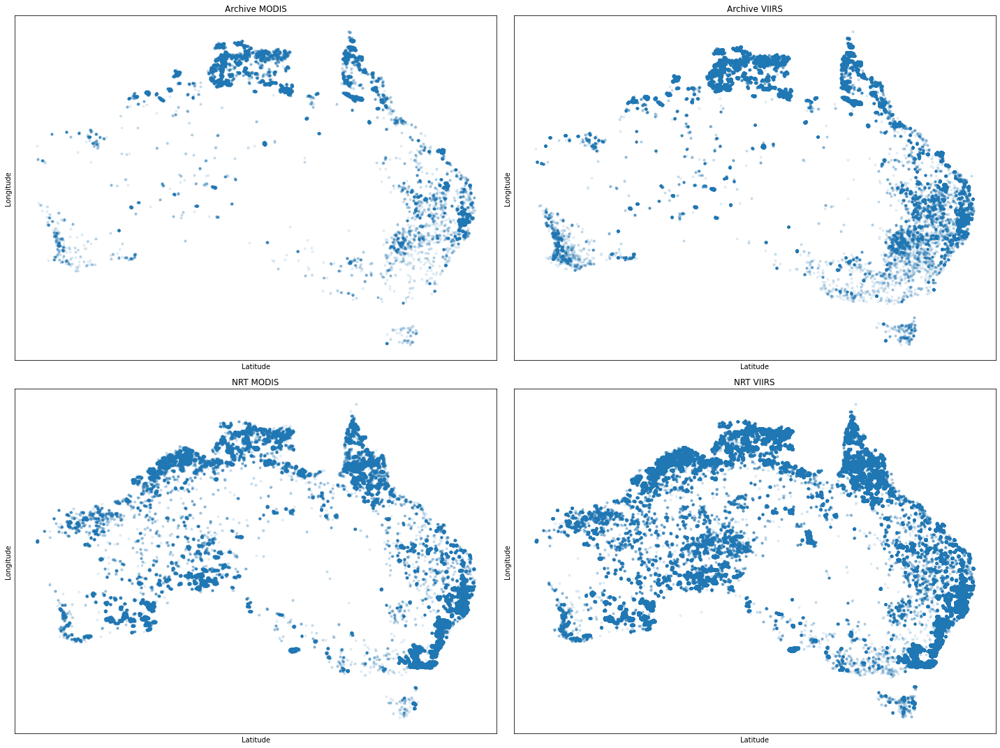

In [6]:
fig,axes=plt.subplots(2,2,figsize=(20,15),subplot_kw={'xticks': (), 'yticks': ()})
axes[0,0].scatter(fam.longitude,fam.latitude,alpha=0.1,marker='.')
axes[0,0].set_title('Archive MODIS')
axes[0,1].scatter(fav.longitude,fav.latitude,alpha=0.1,marker='.')
axes[0,1].set_title('Archive VIIRS')
axes[1,0].scatter(fnm.longitude,fnm.latitude,alpha=0.1,marker='.')
axes[1,0].set_title('NRT MODIS')
axes[1,1].set_title('NRT VIIRS')
axes[1,1].scatter(fnv.longitude,fnv.latitude,alpha=0.1,marker='.')
for ax in axes.ravel():
    ax.set_xlabel('Latitude')
    ax.set_ylabel('Longitude')
plt.tight_layout()

In [7]:
f=folium.Figure(height=1000,width=1000)
clat=-24.003249
clon= 133.737310
m= folium.Map(location=[clat,clon],control_scale=True,zoom_start=4,width=750,height=500,zoom_control=True).add_to(f)
for i in range(0,fam.shape[0]):
    location=[fam.iloc[i]['latitude'], fam.iloc[i]['longitude']]
    folium.CircleMarker(location,radius=1,color='red').add_to(m)
m

In [ ]:
f=folium.Figure(height=1000,width=1000)
clat=-24.003249
clon= 133.737310
m= folium.Map(location=[clat,clon],control_scale=True,zoom_start=4,width=750,height=500,zoom_control=True).add_to(f)
for i in range(0,fnv.shape[0]):
    location=[fnv.iloc[i]['latitude'], fnv.iloc[i]['longitude']]
    if fnv.iloc[i]['daynight']=='N':
        if 400>=fnv.iloc[i]['bright_ti4']>=300:
            col='#F633FF'
        else:
            col="#33F9FF"
    else:
        if 400>=fnv.iloc[i]['bright_ti4']>=300:
            col='#FF3333'
        else:
            col="#FFD133"
    folium.CircleMarker(location,radius=1,color=col).add_to(m)
m